In [6]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import pydicom
from scipy.interpolate import interp1d

# Paths to files
basepath = "./pregnant_woman_dataset"
dicom_folder_path = basepath+"/pregnant_patient_models/image_data/FETUS_2"  # Path to your DICOM folder
tcm_file_path = basepath+"/pregnant_patient_models/tcm_files/fetus2_tcm.txt"
size_topo_path = basepath+"/pregnant_patient_models/size_metrics/topo/fetus2_topo_size.txt"
image_size_path = basepath+"/pregnant_patient_models/size_metrics/image/fetus2_image_size.txt"
equivalent_source_cdf_path = basepath+"/scanner_characteristics/Siemens_SOMATOM_Definition_AS/spectra_cdf/as64_120_w1_opt_spec.txt"
bowtie_filter_file_path=basepath+"/scanner_characteristics/Siemens_SOMATOM_Definition_AS/bowtie_filtration_profiles/as64_120_w1_opt_filt.txt"

Loading DICOM voxel model data...
Tube voltage found: 120
DICOM voxel model loaded with shape: (92, 512, 512)
Loading TCM profile...
TCM profile loaded with shape: (4591, 3)
Loading size topo data...
Size topo data loaded with shape: (461, 5)
Loading image size data...
Image size data loaded with length: 92
Loading bowtie filter profile...
Bowtie filter profile loaded with 75 entries.
Loading equivalent source CDF...
Equivalent source CDF loaded with 140 energy bins.
Starting Monte Carlo simulation...
Simulation 1/10
Index: 0, Z: 0, Tissue Code: 50
Current: 152.47, Density: 0.0, Angle: 0.0, Depth Factor: 0.50954, Dw Factor: 24.915, Attenuation: 0.8676921904770633
Dose Adjustment: 0.0, Mask Sum: 168
Index: 0, Z: 0, Tissue Code: 51
Current: 152.47, Density: 0.05, Angle: 0.0, Depth Factor: 0.50954, Dw Factor: 24.915, Attenuation: 0.8676921904770633
Dose Adjustment: 6.614851414101891, Mask Sum: 158
Index: 0, Z: 0, Tissue Code: 52
Current: 152.47, Density: 0.13, Angle: 0.0, Depth Factor: 0.

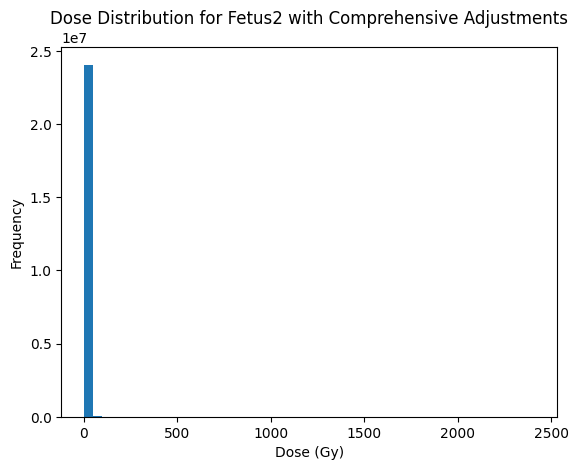

In [8]:
# Load DICOM voxel model
def load_dicom_voxel_model(dicom_folder):
    print("Loading DICOM voxel model data...")
    dicom_files = [os.path.join(dicom_folder, f) for f in os.listdir(dicom_folder) if f]
    dicom_files.sort()  # Ensure files are ordered by slice position
    
    # Load the first DICOM file to get image dimensions
    sample_dicom = pydicom.dcmread(dicom_files[0])
    if 'KVP' in sample_dicom:
        tube_voltage = sample_dicom.KVP  # Tube voltage in kVp
        print(f"Tube voltage found: {tube_voltage}")
    else:
        print(f"Tube voltage not found in file")

    img_shape = (len(dicom_files), sample_dicom.Rows, sample_dicom.Columns)
    
    # Initialize the voxel model array
    voxel_model = np.zeros(img_shape, dtype=float)
    
    # Load each slice into the voxel model
    for i, file in enumerate(dicom_files):
        ds = pydicom.dcmread(file)
        voxel_model[i, :, :] = ds.pixel_array  # Assuming pixel_array contains density data
    
    print("DICOM voxel model loaded with shape:", voxel_model.shape)
    return voxel_model

# Load TCM profile
def load_tcm_profile(file_path):
    print("Loading TCM profile...")
    tcm_data = pd.read_csv(file_path, delimiter=" ", skiprows=1, header=None,
                           names=["z", "theta", "current"])
    print("TCM profile loaded with shape:", tcm_data.shape)
    return tcm_data

# Load size metrics (fetal depth and patient perimeter)
def load_size_topo(file_path):
    print("Loading size topo data...")
    size_data = pd.read_csv(file_path, header=None, names=["index", "depth", "AP", "LAT", "Dw"])
    print("Size topo data loaded with shape:", size_data.shape)
    return size_data

# Load image size data (Dw) from text file
def load_image_size(file_path):
    print("Loading image size data...")
    with open(file_path, 'r') as f:
        image_size_data = [float(line.strip()) for line in f]
    print("Image size data loaded with length:", len(image_size_data))
    return image_size_data

# Load Equivalent Source CDF
def load_equivalent_source_cdf(file_path):
    print("Loading equivalent source CDF...")
    cdf = np.loadtxt(file_path)  # Load cumulative probabilities
    energies_keV = np.arange(1, len(cdf) + 1)  # Energies from 1 keV to 140 keV
    print(f"Equivalent source CDF loaded with {len(cdf)} energy bins.")
    return energies_keV, cdf

# Load bowtie filter profile
def load_bowtie_filter_profile(file_path):
    print("Loading bowtie filter profile...")
    data = np.loadtxt(file_path)
    path_lengths_cm = data[:, 0]  # Equivalent path length of aluminum in cm
    fan_half_angles_deg = data[:, 1]  # Fan half-angle in degrees
    print(f"Bowtie filter profile loaded with {len(path_lengths_cm)} entries.")
    return path_lengths_cm, fan_half_angles_deg

# Tissue densities based on dataset documentation
tissue_densities = {
    50: 0.00,   # air
    51: 0.05,   # lung
    52: 0.13,   # lung
    53: 0.30,   # lung
    54: 0.47,   # lung
    55: 0.65,   # lung
    56: 0.85,   # fat or soft tissue
    57: 0.93,   # fat or soft tissue
    58: 0.98,   # fat or soft tissue
    59: 1.00,   # water
    60: 1.06,   # muscle
    61: 1.14,   # muscle
    62: 1.26,   # muscle
    63: 1.48,   # bone
    64: 1.68,   # bone
    65: 1.89,   # bone
    66: 2.10,   # bone
    89: 1.48,   # fetal bone
    90: 1.06,   # fetal tissue
    91: 1.00,   # gestational sac
    92: 1.14    # uterus
}

# Dose calculation function with TCM and size-based attenuation using Dw (Image Size Data)
def calculate_dose(voxel_model, tcm_data, size_data, image_size_data, energies_keV, cdf, path_lengths_cm, fan_half_angles_deg, num_simulations=10):
    print("Starting Monte Carlo simulation...")
    doses = np.zeros_like(voxel_model, dtype=float)

    # Create interpolation function for bowtie filter attenuation
    bowtie_angle_to_path_length = interp1d(fan_half_angles_deg, path_lengths_cm, fill_value="extrapolate")

    # Mass attenuation coefficients for aluminum (mu in cm^2/g)
    # You can obtain these values from NIST or other databases
    # For simplicity, we'll assume a constant mu for aluminum
    # Ideally, you'd have mu values for each energy
    mu_aluminum = 0.166  # cm^2/g (example value at ~70 keV)
    density_aluminum = 2.699  # g/cm^3

    for sim in range(num_simulations):
        print(f"Simulation {sim + 1}/{num_simulations}")
        for index, row in tcm_data.iterrows():
            z = int(row['z'] * 10)
            angle = row['theta']
            current = row['current']
            
            # Skip if z is out of bounds
            if z < 0 or z >= voxel_model.shape[0]:
                print(f"Skipping out-of-bounds slice: {z}")
                continue
            
            # Safe retrieval of depth_factor
            depth_row = size_data.loc[size_data['index'] == index, 'depth']
            depth_factor = depth_row.values[0] if not depth_row.empty else 1.0
            
            # Safe indexing for image_size_data
            dw_factor = image_size_data[index] if index < len(image_size_data) else image_size_data[-1]
            attenuation_size = 1 / (1 + 0.01 * depth_factor * dw_factor)
            attenuation_size = min(attenuation_size, 1.0)

            # Number of photons to simulate for this projection
            num_photons = int(current)  # Adjust as needed
            
            # Sample photon energies
            random_numbers = np.random.uniform(0, 1, num_photons)
            photon_energies = np.interp(random_numbers, cdf, energies_keV)

             # Calculate bowtie attenuation for each photon
            path_length = bowtie_angle_to_path_length(angle)
            thickness_cm = path_length  # Since path_length is in cm
            mu_total = mu_aluminum * density_aluminum  # Total linear attenuation coefficient (cm^-1)
            bowtie_attenuation = np.exp(-mu_total * thickness_cm)

            # Adjust for size-based attenuation
            total_attenuation = attenuation_size * bowtie_attenuation
            
            for tissue_code, density in tissue_densities.items():
                tissue_mask = (voxel_model[z, :, :] == tissue_code)
                # Use abs() to ensure dose adjustments are positive
                dose_adjustment = current * density * abs(np.cos(np.radians(angle))) * total_attenuation
                doses[z, :, :][tissue_mask] += dose_adjustment

                # Debugging outputs
                print(f"Index: {index}, Z: {z}, Tissue Code: {tissue_code}")
                print(f"Current: {current}, Density: {density}, Angle: {angle}, Depth Factor: {depth_factor}, Dw Factor: {dw_factor}, Attenuation: {total_attenuation}")
                print(f"Dose Adjustment: {dose_adjustment}, Mask Sum: {np.sum(tissue_mask)}")


    average_dose = doses / num_simulations
    print("Monte Carlo simulation completed.")
    return average_dose

# Load all necessary data
voxel_model = load_dicom_voxel_model(dicom_folder_path)
tcm_profile = load_tcm_profile(tcm_file_path)
size_data = load_size_topo(size_topo_path)
image_size_data = load_image_size(image_size_path)
path_lengths_cm, fan_half_angles_deg = load_bowtie_filter_profile(bowtie_filter_file_path)
energies_keV, cdf = load_equivalent_source_cdf(equivalent_source_cdf_path)

# Run the Monte Carlo simulation
average_dose = calculate_dose(voxel_model, tcm_profile, size_data, image_size_data,energies_keV, cdf, path_lengths_cm, fan_half_angles_deg)

# Visualize the results
plt.hist(average_dose.flatten(), bins=50)
plt.xlabel("Dose (Gy)")
plt.ylabel("Frequency")
plt.title("Dose Distribution for Fetus2 with Comprehensive Adjustments")
plt.show()


Loading DICOM slices from: ./pregnant_woman_dataset/pregnant_patient_models/image_data/FETUS_2
Successfully read: ./pregnant_woman_dataset/pregnant_patient_models/image_data/FETUS_2/IM000025, shape: (512, 512)
Successfully read: ./pregnant_woman_dataset/pregnant_patient_models/image_data/FETUS_2/IM000022, shape: (512, 512)
Successfully read: ./pregnant_woman_dataset/pregnant_patient_models/image_data/FETUS_2/IM000014, shape: (512, 512)
Successfully read: ./pregnant_woman_dataset/pregnant_patient_models/image_data/FETUS_2/IM000013, shape: (512, 512)
Successfully read: ./pregnant_woman_dataset/pregnant_patient_models/image_data/FETUS_2/IM000047, shape: (512, 512)
Successfully read: ./pregnant_woman_dataset/pregnant_patient_models/image_data/FETUS_2/IM000078, shape: (512, 512)
Successfully read: ./pregnant_woman_dataset/pregnant_patient_models/image_data/FETUS_2/IM000040, shape: (512, 512)
Successfully read: ./pregnant_woman_dataset/pregnant_patient_models/image_data/FETUS_2/IM000082, sha

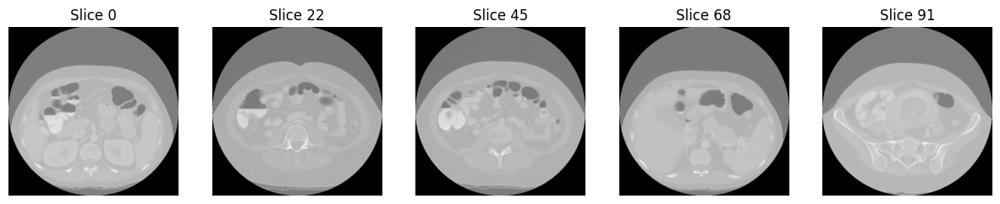

In [9]:
# Updated function to load DICOM slices from FETUS_2 folder
def load_dicom_slices(dicom_folder):
    print(f"Loading DICOM slices from: {dicom_folder}")
    dicom_files = [os.path.join(dicom_folder, f) for f in os.listdir(dicom_folder)]

    slices = []
    for file in dicom_files:
        try:
            # Attempt to read each file as a DICOM
            ds = pydicom.dcmread(file)
            slices.append(ds.pixel_array)
            print(f"Successfully read: {file}, shape: {ds.pixel_array.shape}")
        except Exception as e:
            # If a file cannot be read as a DICOM, skip it and print the error
            print(f"Failed to read {file} as DICOM. Error: {e}")

    print(f"Loaded {len(slices)} DICOM slices.")
    return slices

# Plotting function to visualize a few DICOM slices
def plot_dicom_slices(slices, num_slices=5):
    if not slices:
        print("No DICOM slices available to plot.")
        return

    fig, axs = plt.subplots(1, num_slices, figsize=(15, 5))
    slice_indices = np.linspace(0, len(slices) - 1, num_slices, dtype=int)

    for i, idx in enumerate(slice_indices):
        axs[i].imshow(slices[idx], cmap='gray')
        axs[i].set_title(f"Slice {idx}")
        axs[i].axis('off')

    plt.show()

# Load and plot the slices
slices = load_dicom_slices(dicom_folder_path)
plot_dicom_slices(slices, num_slices=5)


Loading DICOM slice 80 from: ./pregnant_woman_dataset/pregnant_patient_models/image_data/FETUS_2
Successfully read: ./pregnant_woman_dataset/pregnant_patient_models/image_data/FETUS_2/IM000056, shape: (512, 512)


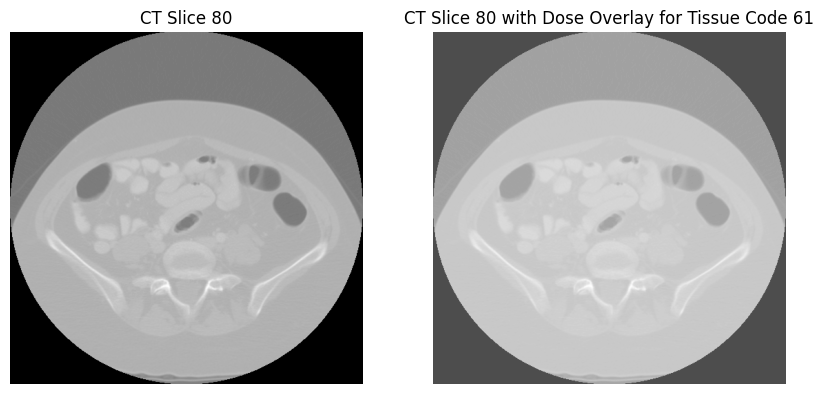

In [10]:
# Assuming you already have `voxel_model`, `average_dose`, and DICOM slices loaded.

def load_specific_dicom_slice(dicom_folder, slice_index):
    print(f"Loading DICOM slice {slice_index} from: {dicom_folder}")
    dicom_files = [os.path.join(dicom_folder, f) for f in os.listdir(dicom_folder)]

    try:
        # Attempt to read the specific file as a DICOM
        ds = pydicom.dcmread(dicom_files[slice_index])
        slice_data = ds.pixel_array
        print(f"Successfully read: {dicom_files[slice_index]}, shape: {slice_data.shape}")
    except Exception as e:
        # If the file cannot be read as a DICOM, print the error
        print(f"Failed to read {dicom_files[slice_index]} as DICOM. Error: {e}")
        slice_data = None

    return slice_data

# Plot dose distribution for a specific tissue type
def plot_specific_tissue_dose(dicom_folder, voxel_model, average_dose, tissue_code, slice_index=45):
    # Load the specific DICOM slice
    ct_slice = load_specific_dicom_slice(dicom_folder, slice_index)
    
    # Get the corresponding dose slice from `average_dose`
    dose_slice = average_dose[slice_index, :, :]
    
    # Get the corresponding tissue mask from `voxel_model`
    tissue_mask = (voxel_model[slice_index, :, :] == tissue_code)
    
    # Apply the tissue mask to the dose slice
    masked_dose_slice = np.ma.masked_where(~tissue_mask, dose_slice)
    
    # Plotting the CT image with an overlay of the dose distribution for the specific tissue
    plt.figure(figsize=(10, 5))

    # Plot the CT slice
    plt.subplot(1, 2, 1)
    plt.imshow(ct_slice, cmap='gray')
    plt.title(f"CT Slice {slice_index}")
    plt.axis('off')

    # Plot the dose overlay for the specific tissue
    plt.subplot(1, 2, 2)
    plt.imshow(ct_slice, cmap='gray', alpha=0.7)
    plt.imshow(masked_dose_slice, cmap='hot', alpha=0.3)  # Hot colormap for dose
    plt.title(f"CT Slice {slice_index} with Dose Overlay for Tissue Code {tissue_code}")
    plt.axis('off')

    plt.show()

# Visualize dose overlay for fetal bone (tissue code 89) on slice 45
plot_specific_tissue_dose(dicom_folder_path, voxel_model, average_dose, tissue_code=61, slice_index=80)

